In [1]:
import os
import glob
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
from tensorflow.keras.layers import *
from tensorflow import keras
from tensorflow.keras.optimizers import *
from tensorflow.keras import layers

In [3]:
import warnings

warnings.simplefilter(action = "ignore", category = RuntimeWarning)

In [4]:
where_to_save = r"G:\My Drive\2021fall\NRE5545\modules\project\data\4. predictions"

In [5]:
model_files = glob.glob(r"G:\My Drive\2021fall\NRE5545\modules\project\code\*.h5")
model_files = model_files[:5]

In [6]:
model_files

['G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\amit_unet_v1.h5',
 'G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\amit_unet_v2.h5',
 'G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\amit_unet_v1_test.h5',
 'G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\amit_test_2021Dec03062658.h5',
 'G:\\My Drive\\2021fall\\NRE5545\\modules\\project\\code\\unetv2_anothertest_2021Dec03083020.h5']

In [7]:
models = [keras.models.load_model(model_file) for model_file in model_files]

Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Instructions for updating:
Call initializer instance with the dtype argument instead of passing it to the constructor


In [8]:
train = pd.read_csv(r"G:\My Drive\2021fall\NRE5545\modules\project\data\3. processed_images\train.csv")
validation = pd.read_csv(r"G:\My Drive\2021fall\NRE5545\modules\project\data\3. processed_images\validation.csv")

train_x = np.array([np.load(f) for f in train['x'].tolist()[:]])
train_y = np.array([np.load(f) for f in train['y'].tolist()[:]])
val_x = np.array([np.load(f) for f in validation['x'].tolist()[:]])
val_y = np.array([np.load(f) for f in validation['y'].tolist()[:]])

In [9]:
print(train_x.shape, train_y.shape, val_x.shape, val_y.shape)

(300, 320, 320, 6) (300, 320, 320, 2) (123, 320, 320, 6) (123, 320, 320, 2)


In [10]:
for i, sample in enumerate(val_x):
    sample = np.expand_dims(sample,0)
    predictions = np.array([model.predict(sample) for model in models])
    
    temp = validation['y'].tolist()[i]
    filename = os.path.basename(temp)
    temp = os.path.dirname(temp) # to get folder name
    folder = os.path.basename(temp)
    if not os.path.exists(os.path.join(where_to_save, folder)):
        os.mkdir(os.path.join(where_to_save, folder))
    
    for j,prediction in enumerate(predictions):
        new_filename = os.path.join(where_to_save, folder, f"{os.path.basename(model_files[j]).replace('.h5','')}_{filename}")
        if not os.path.exists(new_filename):
            np.save(new_filename,prediction)

In [11]:
losses = [model.evaluate(val_x, val_y) for model in models]
losses

123/123 [==============================] - 1s 6ms/sample - loss: 0.2097 - acc: 0.9098


[0.21427492034144519,
 0.23129345052610567,
 [0.8650129742738677, 0.50644404],
 [0.2295092939119029, 0.9041979],
 [0.2097450846094426, 0.90983564]]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

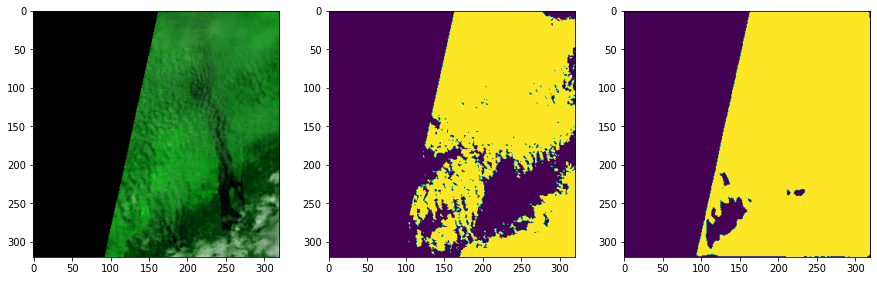

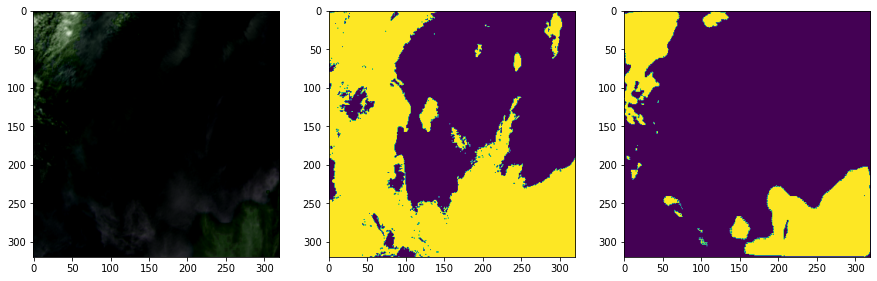

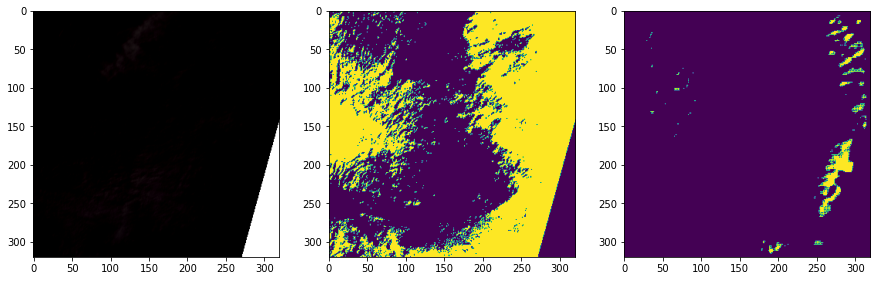

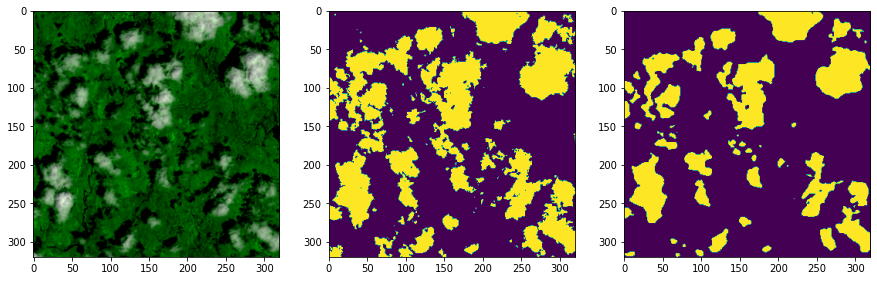

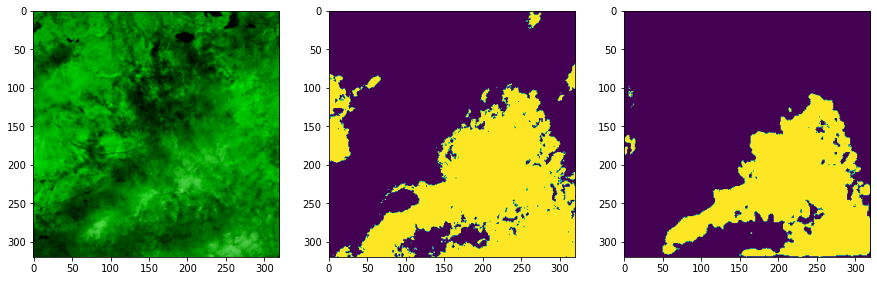

...

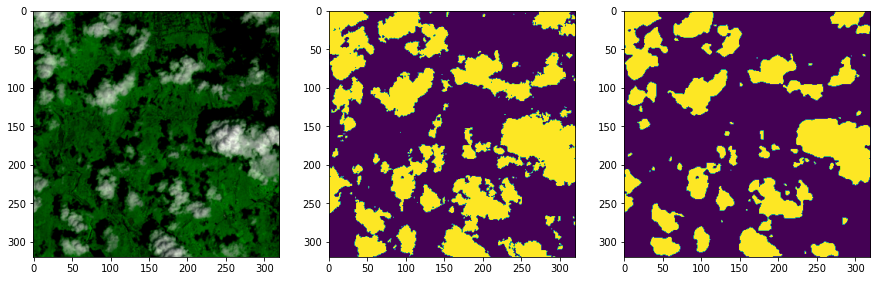

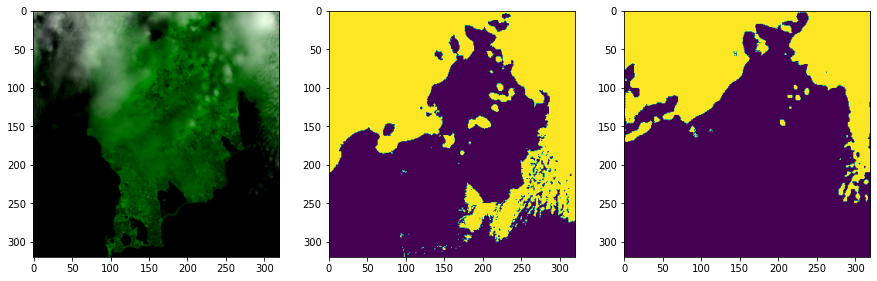

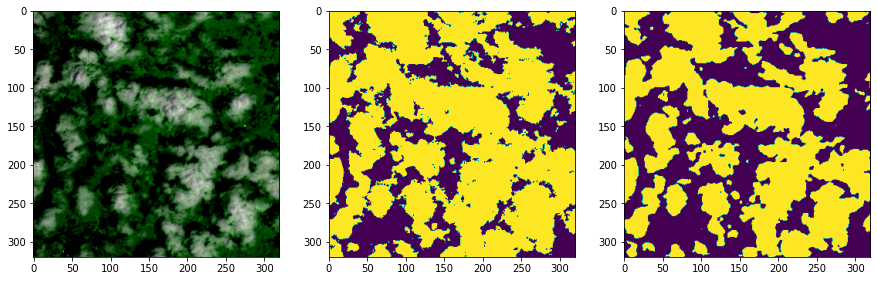

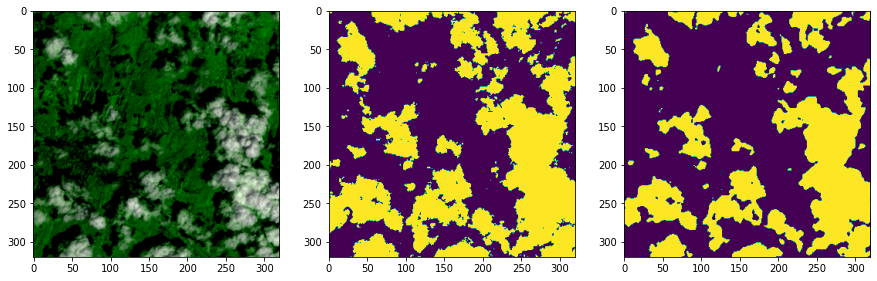

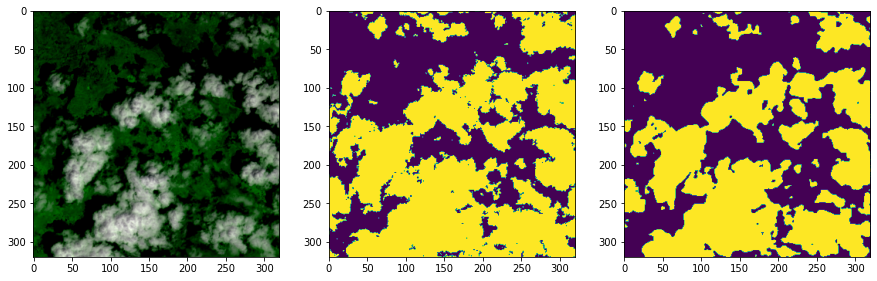

In [12]:
iou = []
bestmodel = model_files[-1]
random_image_files = validation['x'].tolist()[:]#random.choices(validation['x'], k=15)
for f in random_image_files:
    image = np.load(f)
    img3 = image[:,:,[2,3,1]]
    
    f_mask = os.path.join(os.path.dirname(f), os.path.basename(f).replace('_6.npy','_2.npy').replace('x','y'))
    mask = np.load(f_mask)[:,:,1].astype(np.int)
    
    t1 = os.path.basename(bestmodel).replace('.h5','')
    t2 = f'{t1}_{os.path.basename(f_mask)}'
    f_pred = os.path.join(os.path.dirname(f_mask), t2).replace('3. processed_images','4. predictions')
    temp = np.load(f_pred)[0][:,:,1]
    pred = np.zeros(temp.shape)
    pred[temp>=0.6] = 1
    
    iou.append(np.sum(pred==mask)/np.sum(pred>-10000))
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize = [15,5])
    ax1.imshow(img3)
    ax2.imshow(mask)   
    ax3.imshow(pred)

In [13]:
iou

[0.853447265625,
 0.657275390625,
 0.55283203125,
 0.895078125,
 0.902041015625,
 0.89947265625,
 0.905283203125,
 0.770751953125,
 0.89794921875,
 0.920419921875,
 0.89310546875,
 0.90158203125,
 0.931181640625,
 0.676748046875,
 0.9526171875,
 0.928759765625,
 0.759111328125,
 0.885224609375,
 0.918173828125,
 0.866416015625,
 0.673125,
 0.84408203125,
 0.85185546875,
 0.818916015625,
 0.925390625,
 0.888935546875,
 0.876826171875,
 0.922626953125,
 0.8055859375,
 0.937314453125,
 0.926123046875,
 0.904931640625,
 0.9005859375,
 0.93580078125,
 0.75302734375,
 0.950673828125,
 0.65609375,
 0.922099609375,
 0.9359765625,
 0.863564453125,
 0.90431640625,
 0.878623046875,
 0.853251953125,
 0.839765625,
 0.427998046875,
 0.92634765625,
 0.99677734375,
 0.87841796875,
 0.959384765625,
 0.934638671875,
 0.886748046875,
 0.8658984375,
 0.982021484375,
 0.894072265625,
 0.893115234375,
 0.884677734375,
 0.7938671875,
 0.938662109375,
 0.786669921875,
 0.709013671875,
 0.929609375,
 0.8975585

In [14]:
np.mean(iou)

0.8743850832063009